In [1]:
import pandas as pd
import numpy as np
import os
import pickle
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import warnings
warnings.filterwarnings('ignore')

from src.Als import Als

# ALS ALGORITHM

#### Here we demonstrate an open-source implementation of ALS algorithm for matrix factorization by using the movielens dataset. The implementation made supports distributed execution, individual regularization parameters for items and users, tolerance adjustment for concluding optimization and is pandas-compatible.

#### In this demonstration, we fit user and item embeddings and also analyze some aspects such as item similarity and how we could make a prediction based on the calculated embeddings.

#### For more information:
#### - https://datasciencemadesimpler.wordpress.com/tag/alternating-least-squares/
#### - http://stanford.edu/~rezab/classes/cme323/S15/notes/lec14.pdf
#### - https://towardsdatascience.com/prototyping-a-recommender-system-step-by-step-part-2-alternating-least-square-als-matrix-4a76c58714a1

# 0. Data Ingestion, initial transformations, general numbers

In [2]:
RATINGS_PATH = './data/input/ml-latest-small/ratings.csv'
data = pd.read_csv(RATINGS_PATH)
data.drop(
    columns='timestamp',
    inplace=True)
data.head()

,userId,movieId,rating
0,1,1,4.0
1,1,3,4.0
2,1,6,4.0
3,1,47,5.0
4,1,50,5.0


In [3]:
MOVIE_MAP_PATH = './data/input/ml-latest-small/movies.csv'
movies = pd.read_csv(MOVIE_MAP_PATH)
movies.head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [4]:
# Let's map original numerical movieId in ratings tf to movie names. Als class will internally
# deal with it numerically
movie_map = {tup.movieId:tup.title for tup in movies.drop(columns='genres').itertuples()}
data['movieId'] = data['movieId'].map(movie_map)
data = data.rename(columns={'movieId':'movieTitle'})
data.head()

,userId,movieTitle,rating
0,1,Toy Story (1995),4.0
1,1,Grumpier Old Men (1995),4.0
2,1,Heat (1995),4.0
3,1,Seven (a.k.a. Se7en) (1995),5.0
4,1,"Usual Suspects, The (1995)",5.0


In [5]:
# Let's see how many user-movie ratings we have
data.shape[0]

100836

In [6]:
# Let's see how many unique movies we have
Als.get_number_items(data,'movieTitle')

9719

In [7]:
# Let's see how many unique users we have
Als.get_number_users(data,'userId')

610

# 1. Calculate Embeddings

--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### The .fit() method is the entry point for executing the ALS algorithm and calculating user and item embeddings. The
#### following inputs are taken:

--------------------------------------------------------------------------------------------------------------------------------------------------------------
   - data (pandas DataFrame): user-item interaction matrix in the form [user_col, item_col, interaction_col].
   
   - user_col (str): column with user ids in data.
   
   - user_col (str): column with item ids in data.
   
   - value_col (str): column with interaction values. 
   
   - dim (int): embedding dimension. Returned user and item embeddings will be 1-D arrays 
   of size dim.
   
   - interaction_type (str): type of interaction between users and items upon which to create embeddings. This is not 
   necessarily the kind of interaction portrayed in <data>, but how the algorithm will process the input user-item
   interaction matrix. Currently supports three kinds of interaction_types:
       > n_interactions: algorithm will count how many user-item interaction events are present in <data>.
    
       > has_interacted: algorithm will check whether a user-item interaction is present in <data> or not.
    
       > rating: algorithm will consider a score a user gives an item. For this mode of operation, user-item
       interaction matrix <data> must already contain ratings in <value_col>.
    
   - lambda_u (float or double): regularization coefficient for user embeddings.
   -lambda_i (float or double): regularization coefficient for item embeddings.

   -initial_U (array-type): initial embedding for users. Must be a 1-D array with <dim> elements. If not specified, will be initialized
   internally with random values from standard normal distribution.
   -initial_i (array-type): initial embedding for items. Must be a 1-D array with <dim> elements. If not specified, will be initialized
   internally with random values from standard normal distribution.

   - tol (float): error tolerance for concluding optimization. For example, if tol=0.1, algorithm will execute until an iteration reduces mse
   in less than 10% wrt to previous iteration mse.

   - njobs (int): number of parallel jobs to execute optimization with.

   - export_dir (str): directory to which user and item embeddings will be exported. If not specified, will not export.
--------------------------------------------------------------------------------------------------------------------------------------------------------------
 #### In the cell below, the .fit() method is called for the movielens sample dataset.

In [8]:
%%time
CALCULATE=False
EMBEDDING_DIR='./data/output/'

if CALCULATE:
    als = Als()
    als.fit(
        data=data,
        user_col='userId',
        item_col='movieTitle',
        value_col='rating',
        dim=100,
        interaction_type='rating',
        lambda_u=0.5,
        lambda_i=0.5,
        tol=0.05,
        njobs=os.cpu_count(),
        export_dir=EMBEDDING_DIR
    )
    # Als object stores user_embedding and item_embedding attributes after fitting
    user_embedding = als.user_embedding
    item_embedding = als.item_embedding
    
else:
    with open(EMBEDDING_DIR+'user_embedding.pkl','rb') as file:
        user_embedding = pickle.load(file)
    with open(EMBEDDING_DIR+'item_embedding.pkl','rb') as file:
        item_embedding = pickle.load(file)

# Gets item (name, value) tuples and values as separate arrays
ITEMS = list(item_embedding.items())
ITEM_VALUES = np.array([tup[1] for tup in ITEMS])

# Gets user (name, value) tuples and values as separate arrays
USERS = list(user_embedding.items())
USER_VALUES = np.array([tup[1] for tup in USERS])

CPU times: user 103 ms, sys: 12.6 ms, total: 115 ms
Wall time: 118 ms


# 2. Explore embedding item similarity

#### In the following items, we analyze the results of the calculated movie embeddings in some ways. A cluster analysis is performed,
#### alongside calculating the top k most similar movies to a given title.

In [9]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import multiprocessing
from functools import partial

### 2.1. Determining the number of clusters for KMeans - elbow method with inertias/silhouette coefficient

In [10]:
def get_metrics_one_ncluster(X, n_clusters):
        
    # Let's fit a KMeans clustering instance with the
    # specified number of clusters
    kmeans = KMeans(
        n_clusters=n_clusters, 
        init='random',
        n_init=10, 
        max_iter=300,
        tol=1e-04,
        n_jobs=1
    )
    kmeans.fit(X)
    clusters = np.array([kmeans.predict(np.reshape(x,(1,-1))) for x in X])\
                                    .reshape((1,-1))[0]
    # Calculates inertia
    inertia = kmeans.inertia_
    # Calculates silhouette
    silhouette = silhouette_score(X=X,
                                  labels=clusters)

    return pd.DataFrame(
        data={
            'n_clusters':[n_clusters],
            'inertia':inertia,
            'silhouette':silhouette,
        }
    )

def plot_elbow_results(plot_df):
    
    # Plots inertia/silhouette by number of clusters
    fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1,figsize=(20,20))
    # Ax1
    ax1.plot(plot_df['n_clusters'],plot_df['inertia'])
    ax1.set_xlabel('Number of Clusters', fontsize=15)
    ax1.set_ylabel('Total inertia', fontsize=15)
    ax1.set_title('Inertia vs Number of clusters', fontsize=15)
    # Ax2
    ax2.plot(plot_df['n_clusters'],plot_df['silhouette'])
    ax2.set_xlabel('Number of Clusters', fontsize=15)
    ax2.set_ylabel('Silhouette coefficient', fontsize=15)
    ax2.set_title('Silhouette coefficient vs Number of clusters', fontsize=15)



def kmeans_elbow(X, min_clusters, max_clusters):
    
    # Let's run the experiment with distributed execution
    eval_clusters = list(range(MIN_CLUSTERS, MAX_CLUSTERS+1))
    pool = multiprocessing.Pool(os.cpu_count())
    results = pool.map(
        partial(get_metrics_one_ncluster, X),
        eval_clusters
    )
    
    # Let's concatenate all individual results into one dataframe
    results_df = pd.DataFrame()
    for exp in results:
        results_df = results_df.append(exp)
    results_df.reset_index(
        drop=True,
        inplace=True
    )
    
    plot_elbow_results(plot_df=results_df)   
    
    return results_df

CPU times: user 50 ms, sys: 465 µs, total: 50.4 ms
Wall time: 47.8 ms


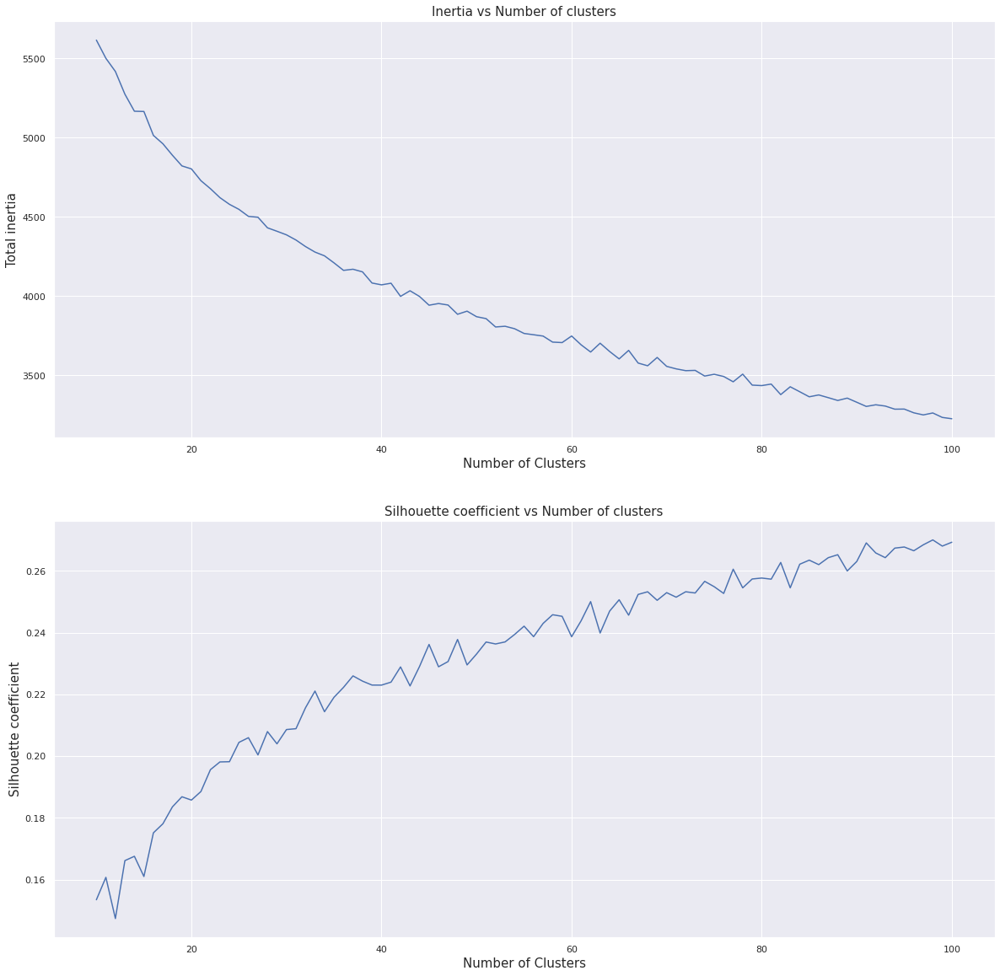

In [11]:
%%time
MIN_CLUSTERS=10
MAX_CLUSTERS=100
CALCULATE_ELBOW=False
ELBOW_OUTPUT_DIR='./data/output/'
if CALCULATE_ELBOW:
    elbow_results = kmeans_elbow(
        X=ITEM_VALUES,
        min_clusters=MIN_CLUSTERS,
        max_clusters=MAX_CLUSTERS
    )
    elbow_results.to_csv(ELBOW_OUTPUT_DIR+'elbow_exp_min{}_max{}.csv'.format(MIN_CLUSTERS, MAX_CLUSTERS))
else:
    elbow_results = pd.read_csv(ELBOW_OUTPUT_DIR+'elbow_exp_min{}_max{}.csv'.format(MIN_CLUSTERS, MAX_CLUSTERS))
    plot_elbow_results(plot_df=elbow_results)

--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### Neither metric gives a very clear saturation elbow. For the following example, we'll take an intermediary value of 50 clusters. For a more rigorous analysis,
#### evaluating a wider range of clusters to check for saturation or the employment of another type of metric/clustering method would be a good procedure.
--------------------------------------------------------------------------------------------------------------------------------------------------------------

### 2.2. Calculating clusters

In [12]:
def get_clusters(n_clusters, id_var, name_emb_tuples, random_seed):
    # df with variable being clustered and embedding
    df = pd.DataFrame(
        columns=[id_var,'embedding'],
        data = {
            id_var:[tup[0] for tup in name_emb_tuples],
            'embedding':[tup[1] for tup in name_emb_tuples],
        }
    )
    
    # Let's run KMeans
    kmeans = KMeans(
        n_clusters=n_clusters, 
        init='random',
        n_init=500,
        max_iter=1000,
        tol=1e-05,
        random_state=random_seed,
        n_jobs=os.cpu_count()
    ).fit(np.array([tup[1] for tup in name_emb_tuples]))

    # Assigns cluster
    df['cluster'] = df['embedding'].apply(lambda x:kmeans.predict(np.reshape(x,(1,-1)))[0])
    return df

In [13]:
%%time
clustered = get_clusters(
    n_clusters=50,
    id_var='movieTitle',
    name_emb_tuples=ITEMS,
    random_seed=10
)
clustered.head()

CPU times: user 11min 7s, sys: 5.12 s, total: 11min 13s
Wall time: 1min 28s


,movieTitle,embedding,cluster
0,Toy Story (1995),"[-0.1096487564754243, -0.018843734896803035, -...",18
1,Grumpier Old Men (1995),"[-0.040606638309715164, 0.0007151350022336112,...",18
2,Heat (1995),"[-0.15366069289730702, -0.08814069752764997, 0...",18
3,Seven (a.k.a. Se7en) (1995),"[0.002829671671491486, -0.05385451240941702, -...",18
4,"Usual Suspects, The (1995)","[-0.053440809286763084, -0.0006863601113748026...",18


### 2.3. Evaluate item similarity: top k most similar items

--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### Here we'll query the calculated embeddings dataset for a given title and return the top k most similar movies to it. By default, we are using
#### euclidean distance in the embedding space, but cosine similarity is also supported by the get_top_k() function. 
#### 
#### Give it a shot and query for different titles!
--------------------------------------------------------------------------------------------------------------------------------------------------------------

In [14]:
def get_top_k(
    df, 
    k, 
    dist_type, 
    id_var, 
    query_name,
    print_info=True
):
    
    # Let's check to see if given movie is listed in the dataset
    if df[df[id_var]==query_name].shape[0]==0:
        raise AssertionError('No results found for {}'.format(query_name))
    
    
    # Get and print cluster and embedding for query movie
    if 'cluster' in df.columns:
        query_clust = df[df[id_var]==query_name]['cluster'].iloc[0]
    query_embed = df[df[id_var]==query_name]['embedding'].iloc[0]
    if print_info:
        print('#'*100)
        print('QUERY NAME: {}'.format(query_name))
        if 'cluster' in df.columns:
            print('CLUSTER: {}'.format(query_clust))
        print('EMBEDDING: {}'.format(query_embed))
        print('#'*100+'\n')
    
    top_k = df.copy(deep=True)
    # Calculates dot-product distances to other items 
    if dist_type=='dot':
        top_k['distance'] = top_k['embedding'].apply(
            lambda x: np.linalg.norm(
                np.subtract(x, query_embed)
            )
        )
    # Calculates cosine similarity distances to other items
    elif dist_type=='cosine':
        top_k['distance'] = top_k['embedding'].apply(
            lambda x:np.dot(x,query_embed)/(np.linalg.norm(x)*np.linalg.norm(query_embed))
        )
        
    # Let's get the items with the smallest distance to queried item
    top_k = top_k[top_k[id_var] != query_name]\
                 .sort_values(by='distance',ascending=True)\
                 .iloc[:k,:]\
                 .drop(columns='embedding')
    
    return top_k.reset_index(drop=True)

In [15]:
QUERY_MOVIE_TITLE='Aladdin (1992)'

get_top_k(
    df=clustered,
    k=20,
    dist_type='dot',
    id_var='movieTitle',
    query_name=QUERY_MOVIE_TITLE,
)

####################################################################################################
QUERY NAME: Aladdin (1992)
CLUSTER: 18
EMBEDDING: [-6.18900255e-02 -9.48940474e-02  7.36255302e-02 -1.23935427e-05
 -2.15517797e-01  7.68177267e-02 -5.62994327e-03  1.35990604e-01
  3.13663112e-02  8.09563289e-02 -8.24158086e-03  1.44689228e-01
  6.22935095e-02  1.87822358e-02 -4.83320770e-02  1.27349375e-01
  1.73743481e-01 -8.32747217e-02 -5.34301841e-02 -5.66902311e-02
  1.39757807e-02  5.53615398e-02 -1.62076218e-01 -8.51587575e-03
 -1.25557970e-01  1.16237219e-01 -1.53777436e-01  6.30521328e-02
 -5.76296294e-02  3.78854782e-02  2.42502022e-02 -1.96736971e-03
  5.58555232e-02 -7.19811171e-02  2.47507793e-02 -7.60686523e-02
 -3.12855808e-02 -2.82405047e-01  1.38859392e-01  8.05849080e-02
  5.86492205e-02  2.93611441e-01  8.91781968e-02 -3.89160973e-02
 -6.66475776e-02 -2.13331504e-02 -9.56736848e-02 -6.67547267e-02
  5.85198530e-02  1.39987607e-01  1.71153046e-01 -1.27960849e-01
  1.

,movieTitle,cluster,distance
0,Beauty and the Beast (1991),18,0.603064
1,"Lion King, The (1994)",18,0.616858
2,Finding Nemo (2003),18,0.666890
3,"Little Mermaid, The (1989)",18,0.675635
4,Shrek (2001),18,0.686994
5,Indiana Jones and the Temple of Doom (1984),18,0.687451
6,Mulan (1998),18,0.694582
7,Forrest Gump (1994),18,0.697293
8,Hook (1991),18,0.704158
9,Jurassic Park (1993),18,0.708240


--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### Seems like our embeddings are giving reasonable results, since the top 20 movies most related to Aladdin are also mostly fantasy movies. It's interesting to point out as well that most related titles are from Disney and around the same year as Aladdin was released, and that all these 21 movies are from the same cluster.
--------------------------------------------------------------------------------------------------------------------------------------------------------------

### 2.4. Item/cluster visualizations
--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### Here we'll visualize the clusters we created by projecting the embeddings onto a 2-D plane, for which we'll user PCA. Altair library will be used to create interactive visualizations.
--------------------------------------------------------------------------------------------------------------------------------------------------------------

In [16]:
from sklearn.decomposition import PCA
import altair as alt
alt.data_transformers.disable_max_rows()


DataTransformerRegistry.enable('default')

In [17]:

def plot_clusters(
    df,
    n_components,
    movie_plot_list=None,
    cluster_plot_list=None
):
    # Let's train our PCA model
    pca_model = PCA(n_components=2)\
                    .fit(
                        np.array([x for x in df['embedding'].values])
                    )

    # Let's apply our PCA model to the movie embeddings
    df['pca_components'] = df['embedding'].apply(
                                               lambda x:pca_model.transform(x.reshape(1,-1))[0]
                                           )
    df[['pca_1','pca_2']] = pd.DataFrame(df.pca_components.tolist(), 
                                         index= df.index)
    
    
    # Let's filter out movies and clusters if movie_plot_list or cluster_plot_list are specified
    if movie_plot_list is not None:
        df = df[df['movieTitle'].isin(movie_plot_list)]
    if cluster_plot_list is not None:
        df = df[df['cluster'].isin(cluster_plot_list)]

    chart = alt.Chart(df).mark_circle(size=60).encode(
        x='pca_1',
        y='pca_2',
        color=alt.Color('cluster', scale=alt.Scale(scheme='accent')),
        tooltip=['movieTitle', 'cluster', 'pca_1', 'pca_2']
    ).properties(
        width=1200,
        height=900
    ).configure_view(
        strokeWidth=0
    )
    return chart


In [18]:
plot_clusters(
    df=clustered,
    n_components=2
)

alt.Chart(...)

--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### A little bit hard to visualize, right? So we'll filter out the 30% most rated movies next.
--------------------------------------------------------------------------------------------------------------------------------------------------------------

In [19]:
SELECTION_FACTOR = 0.3

# Let's get the most frequently rated movies in the dataset, as defined by SELECTION_FACTOR
rating_counts = data.groupby(by='movieTitle',as_index=False)\
                    .agg({'userId':'count'})\
                    .rename(columns={'userId':'ratingCount'})\
                    .sort_values(by='ratingCount',
                                 ascending=False)\
                    .reset_index(drop=True)
plot_movies = rating_counts[
    rating_counts['ratingCount']>rating_counts['ratingCount'].quantile(1-SELECTION_FACTOR)
].movieTitle.values

plot_clusters(
    df=clustered,
    n_components=2,
    movie_plot_list=plot_movies
)

alt.Chart(...)

--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### Seems like clusters 18 and 34 stand out. Let's analyze them in a little more detail!
--------------------------------------------------------------------------------------------------------------------------------------------------------------

In [20]:
plot_clusters(
    df=clustered,
    n_components=2,
    movie_plot_list=plot_movies,
    cluster_plot_list=[18, 34]
)

alt.Chart(...)

--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### Seems like both clusters are predominantly fantasy/action/adventure/superhero movies. However, hovering over our data points we can see that cluster 34 is mostly made up of more recent 21st century movies, while cluster 18 contains older 20th century titles. As ALS rates item similarity based on similar users giving similar ratings, we can think that there's a difference in the users who watch movies from either case.
--------------------------------------------------------------------------------------------------------------------------------------------------------------

# 3. Item recommendation

--------------------------------------------------------------------------------------------------------------------------------------------------------------
#### Let us give an example of how the calculated embeddings could be used for generating a recommendation for a given user. Many approaches are possible, using solely item-based information, solely user-based information or a mixture of item information and user information.
#### Here we'll give an example of a mixed approach, combining both user and item info. The following steps are taken:
#### - 1: we get the top k users most similar to the one we want to recommend to. 
#### - 2: what movies did these similar users like? Let's take these movies as a pre-list for recommending to our user.
#### - 3: in this list, which movies might our user like the most? Let's sort this pre-list by combining our calculated user's embeddings with the pre-selected movies' embeddings and we have recommendations :)
--------------------------------------------------------------------------------------------------------------------------------------------------------------

In [21]:
# Let's get dataframes for our users and items
users_df = pd.DataFrame.from_records(USERS)
users_df.columns = ['userId','embedding']

items_df = pd.DataFrame.from_records(ITEMS)
items_df.columns = ['movieTitle','embedding']

In [24]:
def get_user_movies(
    ui_interaction_df,
    user_name,
    id_var='userId'
):
    return ui_interaction_df[
                ui_interaction_df[id_var]==user_name
            ].sort_values(
                by='rating',
                ascending=False
            ).reset_index(drop=True)


def get_user_recommendations(
    user_embeddings_df,
    item_embeddings_df,
    ui_interaction_df,
    user_name,
    n_related_users,
    n_recommendations,
    dist_type,
    user_id_var='userId',
    item_id_var='movieTitle',
    value_var='rating'
):
    # Let's get the top k related users to the one
    # we are recommending for
    top_k_users = get_top_k(
        df=user_embeddings_df,
        k=n_related_users,
        dist_type=dist_type,
        id_var=user_id_var,
        query_name=user_name,
        print_info=False
    )[user_id_var].values
    
    # Let's get the movies that these related users watched
    related_users_movies = ui_interaction_df[
        (ui_interaction_df[user_id_var].isin(top_k_users))
        &(ui_interaction_df[value_var]>=3)
    ][item_id_var].unique()
    
    # Let's calculate the estimated score our user will have
    # for each of the related users' potential recommendations
    ui_fit_df = item_embeddings_df.copy(deep=True)
    recommend_user_emb = user_embeddings_df[
        user_embeddings_df[user_id_var]==user_name
    ]['embedding'].iloc[0]
    ui_fit_df['estimated_score'] = ui_fit_df['embedding'].apply(
        lambda x:np.dot(x,recommend_user_emb)
    )
    
    # Let's filter out recommendations for items with which
    # the user has already interacted with
    already_interacted = ui_interaction_df[
        ui_interaction_df[user_id_var]==user_name
    ][item_id_var].unique()
    
    ui_fit_df = ui_fit_df[
        ~ui_fit_df[item_id_var].isin(already_interacted)
    ]
    
    return ui_fit_df.sort_values(
                by='estimated_score',
                ascending=False
            ).reset_index(
                drop=True
            ).drop(
                columns=['embedding','estimated_score']
            ).iloc[:n_recommendations,:]

In [25]:
get_user_recommendations(
    user_embeddings_df=users_df,
    item_embeddings_df=items_df,
    ui_interaction_df=data,
    user_name=78,
    n_related_users=50,
    n_recommendations=20,
    dist_type='dot' 
)

,movieTitle
0,Rocky II (1979)
1,"A-Team, The (2010)"
2,Rocky (1976)
3,Liar Liar (1997)
4,Moonraker (1979)
5,Rocky III (1982)
6,"Karate Kid, Part III, The (1989)"
7,Desperado (1995)
8,First Blood (Rambo: First Blood) (1982)
9,"Man with the Golden Gun, The (1974)"


In [27]:
get_user_movies(
    ui_interaction_df=data,
    user_name=78
).head(30)

,userId,movieTitle,rating
0,78,Airplane! (1980),5.0
1,78,"Terminator, The (1984)",5.0
2,78,Die Hard (1988),5.0
3,78,Ghostbusters (a.k.a. Ghost Busters) (1984),4.5
4,78,Terminator 2: Judgment Day (1991),4.5
5,78,"Shawshank Redemption, The (1994)",4.5
6,78,Raiders of the Lost Ark (Indiana Jones and the...,4.5
7,78,"Naked Gun: From the Files of Police Squad!, Th...",4.5
8,78,Dodgeball: A True Underdog Story (2004),4.5
9,78,"Matrix, The (1999)",4.5
